In [1]:
import torch
import cv2
from segment_anything import sam_model_registry, SamPredictor
from segment_anything import SamAutomaticMaskGenerator_mod as SamAutomaticMaskGenerator
import numpy as np
import matplotlib.pyplot as plt
import glob
import torch
import clip
from PIL import Image
from tqdm import tqdm
import functions as fnc
from importlib import reload
import gc
from skimage.measure import label, regionprops
from collections import Counter
from torchvision.ops.boxes import batched_nms

In [2]:
OutDIR='/DATA/vito/output/'
DataDIR='/DATA/vito/data/'
#fn_img = glob.glob(DataDIR+'test_img/*')
fn_img = glob.glob(DataDIR+'drone_ortho/*')
fn_img.sort()
print('Available images:')
for i, fn in enumerate(fn_img):
    print(f'{i}:' + fn.split("/")[-1])
print("---------------")

Available images:
0:512patched_LaPaya.npy
1:512patched_mask.npy
2:LaPaya_Apr2024_03May24_orthomosaic_5cm_UTM19S_WGS84.tif
3:LaPaya_Apr2024_orthomosaic_5cm_UTM19S_WGS84.tif
4:Ravi1_DEM_0.6mm.tif
5:Ravi1_Orthomosaic_0.2mm.tif
6:Ravi1_orthomosaic_from_DEM_0.6mm.tif
7:Ravi2_Orthomosaic_0.2mm.tif
8:Ravi2_Orthomosaic_0.2mm_clip1.tif
9:Ravi3_Orthomosaic_0.2mm.tif
10:big_clip.tif
11:small_clip1.tif
12:small_clip2.tif
---------------


In [3]:
image=(np.load(DataDIR+'example/rgb.npy')*255).astype(np.uint8)
#image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
seg_ids=np.load(DataDIR+'example/segment_ids.npy')

In [3]:
img_select=int(input("Select a image: "))
image = cv2.imread(fn_img[img_select])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(fn_img[img_select].split("/")[-1]+' imported')
print('Image size:', image.shape)

Ravi2_Orthomosaic_0.2mm_clip1.tif imported
Image size: (2680, 5125, 3)


In [4]:
MODEL_TYPE = "vit_h"
if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
    print('Currently running on GPU\nModel '+MODEL_TYPE)
else:
    DEVICE = torch.device('cpu')
    print('Currently running on CPU\nModel '+MODEL_TYPE)

if MODEL_TYPE == 'vit_h':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_h_4b8939.pth'
elif MODEL_TYPE == 'vit_l':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_l_0b3195.pth'
else:
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_b_01ec64.pth'

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(sam)


Currently running on GPU
Model vit_h


In [5]:
#load mask
temp_image=fnc.preprocessing_roulette(image, 
                                      {'Crop': {'crop size': 1024, 'j':0},
                                       'Gaussian': {'kernel size':3},
                                       'CLAHE':{'clip limit':3}#,
                                       #'Downsample': {'fxy':4}
                                       }
                                       )

gc.collect()
torch.cuda.empty_cache()

mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=16,
    pred_iou_thresh=0,
    stability_score_thresh=0,#iou by varying cutoff in binary conversion
    box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
    crop_n_layers=0,#cut into 2**n crops
    crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
    crop_n_points_downscale_factor=1,
    crop_overlap_ratio=0,
    #min_mask_region_area=2000,
)
with torch.no_grad():
    masks = mask_generator.generate(temp_image)
#logit_scale=1000
print(len(masks))

768


In [25]:
highest_pred_iou_by_point=[]
for i in np.arange(0,len(masks),3):
    iou=[mask['predicted_iou'] for mask in masks[i:i+3]]
    #highest_pred_iou_by_point.append(masks[np.argmax(iou)+i]['segmentation'])
    highest_pred_iou_by_point.append(masks[np.argmax(iou)+i])

In [27]:
masks=highest_pred_iou_by_point

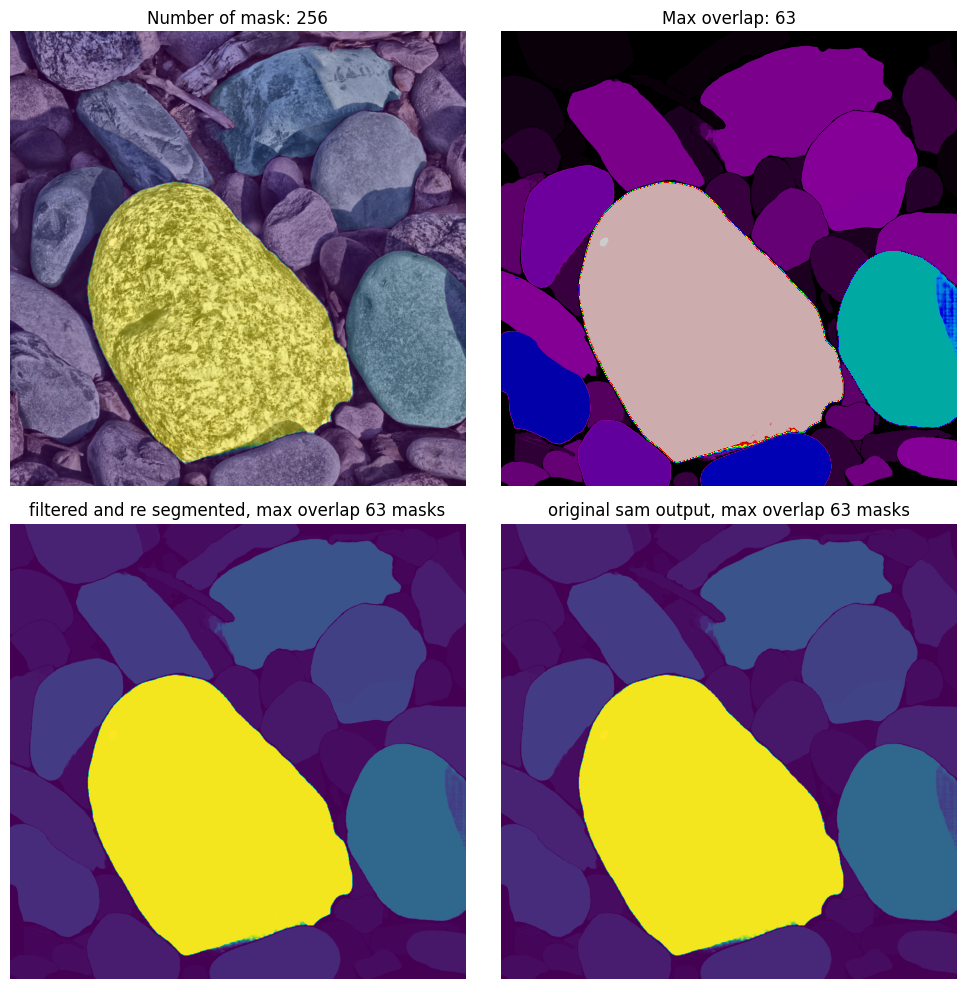

In [24]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(temp_image)
plt.imshow(np.sum(highest_pred_iou_by_point,axis=0),alpha=0.5)
plt.title(f'Number of mask: {len(highest_pred_iou_by_point)}')
plt.axis('off')
plt.subplot(2,2,2)
#plt.imshow(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0))
plt.imshow(np.sum([highest_pred_iou_by_point[i]*(i+1) for i in range(len(highest_pred_iou_by_point))],axis=0), cmap='nipy_spectral')
plt.title(f'Max overlap: {np.max(np.sum(highest_pred_iou_by_point,axis=0))}')
plt.axis('off');
plt.subplot(2,2,3)
plt.imshow(np.sum(highest_pred_iou_by_point,axis=0))
plt.axis('off')
plt.title(f'filtered and re segmented, max overlap {np.max(np.sum(highest_pred_iou_by_point,axis=0))} masks');
plt.subplot(2,2,4)
plt.imshow(np.sum(highest_pred_iou_by_point,axis=0))
plt.axis('off')
plt.title(f'original sam output, max overlap {np.max(np.sum(highest_pred_iou_by_point,axis=0))} masks')
plt.tight_layout()
plt.show()

In [7]:
#load mask
temp_image=fnc.preprocessing_roulette(image, 
                                      {'Crop': {'crop size': 1024, 'j':0},
                                       'Gaussian': {'kernel size':3},
                                       'CLAHE':{'clip limit':3}#,
                                       #'Downsample': {'fxy':4}
                                       }
                                       )

gc.collect()
torch.cuda.empty_cache()

mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=128,
    pred_iou_thresh=0,
    stability_score_thresh=0,#iou by varying cutoff in binary conversion
    box_nms_thresh=0.3,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks
    crop_n_layers=0,#cut into 2**n crops
    crop_nms_thresh=0,#The box IoU cutoff used by non-maximal suppression to filter duplicate masks between crops
    crop_n_points_downscale_factor=1,
    crop_overlap_ratio=0,
    #min_mask_region_area=2000,
)
with torch.no_grad():
    masks = mask_generator.generate(temp_image)
#logit_scale=1000
print(len(masks))

321


In [26]:
predictor = SamPredictor(sam)
predictor.set_image(temp_image)


In [6]:
#NMS filtering
bboxes = torch.tensor([mask['bbox'] for mask in masks], device=DEVICE, dtype=torch.float)
scores = torch.tensor([mask['predicted_iou'] for mask in masks], device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(torch.tensor([mask['bbox'] for mask in masks], device=DEVICE)[:, 0])#torch.tensor(np.ones(len(masks)), device=DEVICE, dtype=torch.int)

keep = batched_nms(bboxes, scores, labels, 0.3)
masks=[masks[i] for i in keep]
len(masks)

284

In [ ]:
#set_overlap = set()

# Iterate through each column of the array
#for i in range(ar_masks_flat.shape[1]):
    # for each pixel find out the idex of mask where the pixel was in a mask
#    nz = np.where(ar_masks_flat[:, i] != 0)[0]
    
    # if there are overlap of mask
#    if len(nz) > 1:
#        nz_tuple = tuple(nz)
#        set_overlap.add(nz_tuple)

# Convert the set back to a list if needed
#list_overlap = list(set_overlap)

#find pixel wise overlaps
#list_overlap=[]
#for i in range(ar_masks_flat.shape[1]):
#    nz=np.nonzero(ar_masks_flat[:,i])[0]#for each pixel find out the idex of mask where the pixel was in a mask
#    if len(nz)>1:#if there are overlap of mask
#        if not any(np.array_equal(nz, arr) for arr in list_overlap):
#            list_overlap.append(nz)
#list_overlap1=[ np.nonzero(ar_masks_flat[:,i])[0] for i in range(ar_masks_flat.shape[1]) if len(np.nonzero(ar_masks_flat[:,i])[0])>1]

In [28]:
list_of_pred_iou=[mask['predicted_iou'] for mask in masks]
list_of_stability_score=[mask['stability_score'] for mask in masks]
#list_of_logits=[mask['p_mask'] for mask in masks]

In [29]:
list_of_masks = [fnc.clean_mask(mask['segmentation'].astype(np.uint8)) for mask in masks]#remove small disconnected parts
ar_masks=np.stack(list_of_masks)
ar_masks_flat=ar_masks.reshape((ar_masks.shape[0],ar_masks.shape[1]*ar_masks.shape[2]))#flat 2d to 1d masks

#find pixel wise overlaps
list_overlap=[]
# Iterate through each column of the array
for i in range(ar_masks_flat.shape[1]):
    # for each pixel find out the idex of mask where the pixel was in a mask
    nz = np.where(ar_masks_flat[:, i] != 0)[0]
    
    # if there are overlap of mask
    if len(nz) > 1:
        list_overlap.append(tuple(nz))

#get uniqe pairs and intersection area(pixel) for each pair
#list_overlap_intersection=[np.unique(np.sum([list_of_masks[i] for i in overlap],axis=0), return_counts=True)[1][-1] for overlap in list_overlap]
group_counter=Counter(list_overlap)
unique_groups = [list(tup) for tup in group_counter.keys()]
group_overlap_area = list(group_counter.values())


In [30]:

#filter by intersection area
threshold=1000
filtered=np.array(group_overlap_area)>threshold
unique_groups_thresholded=[unique_groups[i] for i in range(len(unique_groups)) if filtered[i]]
#list_overlap_threshold=[list_overlap[i] for i in range(len(list_overlap_intersection)) if list_overlap_intersection[i] > threshold]

#report filter
print(f'Threshold: {threshold} pixels, {len(list_overlap)-len(unique_groups_thresholded)} groups removed',
      f'\nOverlap groups before filtering: {len(list_overlap)}, after filtering: {len(unique_groups_thresholded)}')

Threshold: 1000 pixels, 924755 groups removed 
Overlap groups before filtering: 924796, after filtering: 41


In [31]:
#get centroid
list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_masks]

In [32]:
#groupping overlaps

#check if there is remaining ungroupped pairs
checker=np.zeros(len(masks))
for gp in unique_groups_thresholded:
    for i in gp:
        checker[i]+=1
remaining_ungroupped=np.max(np.unique(checker))

cleaned_groups=None#dummy to identify first run

while remaining_ungroupped>1:#keep groupping until there is no overlapping groups
    groups=[]

    if not cleaned_groups:#the first run
        temp_list_overlap=unique_groups_thresholded.copy()
    else:#>2 run
        temp_list_overlap=cleaned_groups.copy()

    while len(temp_list_overlap)>1:
        temp_group=temp_list_overlap[0].copy()
        remaining=[]
        for i in np.arange(1,len(temp_list_overlap),1):
            num_common_val=len(np.intersect1d(temp_list_overlap[0],temp_list_overlap[i]))
            if num_common_val!=0:
                temp_group=np.hstack((temp_group,temp_list_overlap[i]))
            else:
                remaining.append(temp_list_overlap[i])
        temp_list_overlap=remaining.copy()
        groups.append(temp_group)
    if len(remaining)>0:
        groups.append(remaining[0])

    #remove duplicated index after stacking
    cleaned_groups=[np.unique(group) for group in groups]

    checker=np.zeros(len(masks))
    for gp in cleaned_groups:
        for i in gp:
            checker[i]+=1
    remaining_ungroupped=np.max(np.unique(checker))

In [33]:
print(f'{len(cleaned_groups)} groups found\n')
if len(np.unique(np.hstack(cleaned_groups)))==len(np.unique(np.hstack(list_overlap))):
    if np.sum(np.unique(np.hstack(cleaned_groups))==np.unique(np.hstack(list_overlap))):
        print('nothing missing')
    else:
        print('Warning: something missing')
else:
    print('Warning: total number not match')

37 groups found



In [34]:
all_grouped_masks=np.unique(np.hstack(cleaned_groups))
if len(all_grouped_masks)!=len(list_of_masks):
    list_of_nooverlap_mask=np.setdiff1d(np.arange(len(list_of_masks)), all_grouped_masks)
else:
    list_of_nooverlap_mask=[]

In [14]:
for i in cleaned_groups[0]:
    print(i)
    print((regionprops(label(list_of_masks[i])))[0].area)

40
16161.0
47
3795.0
153
20273.0
190
4239.0
206
6617.0


In [98]:
mask1=list_of_masks[62]
mask2=list_of_masks[51]
intersection = np.logical_and(mask1, mask2)

# Calculate the union
union = np.logical_or(mask1, mask2)

# Calculate the IoU
iou = np.sum(intersection) / np.sum(union)
iou

0.0

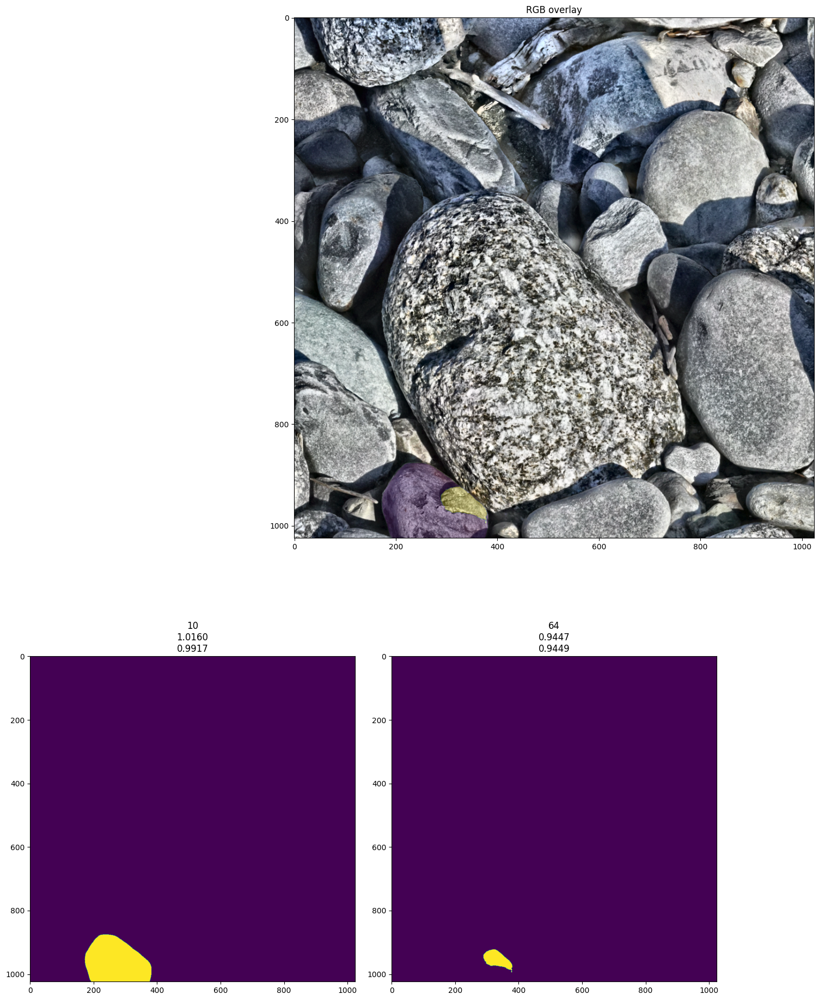

In [137]:
#plot group
import matplotlib.gridspec as gridspec
k=9
# Create a figure
fig = plt.figure(figsize=(20, 20))

num_rows=int(np.ceil((len(cleaned_groups[k])/3)))+1
gs = gridspec.GridSpec(num_rows, 3, height_ratios=list((np.ones(num_rows).astype(int))))

ax_big = fig.add_subplot(gs[0, :])
ax_big.imshow(temp_image)
temp=np.sum(np.stack([list_of_masks[i] for i in cleaned_groups[k]]),axis=0)
temp=np.ma.masked_where(temp==0,temp)
ax_big.imshow(temp, alpha=0.3)
ax_big.set_title('RGB overlay')

j=0
for i in range(len(cleaned_groups[k])):
    ax = fig.add_subplot(gs[(i//3)+1, j])
    ax.imshow(list_of_masks[cleaned_groups[k][i]])
    ax.set_title(f'{cleaned_groups[k][i]}\n{list_of_pred_iou[cleaned_groups[k][i]]:.4f}\n{list_of_stability_score[cleaned_groups[k][i]]:.4f}')

    if j==2:
        j=0
    else:
        j+=1

plt.tight_layout()
plt.show()

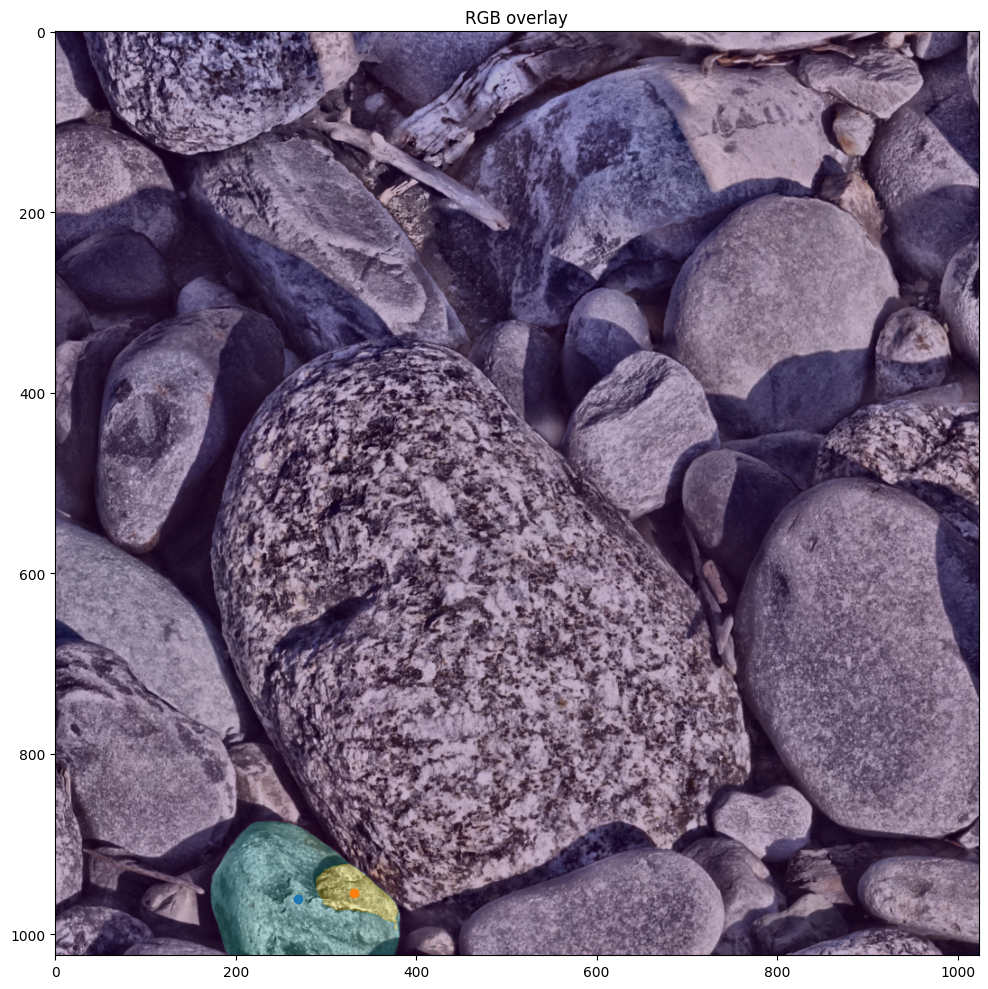

In [100]:
#plot group centroid
k=9

fig = plt.figure(figsize=(10, 10))

plt.imshow(temp_image)
plt.imshow(np.sum(np.stack([list_of_masks[i] for i in cleaned_groups[k]]),axis=0), alpha=0.3)
plt.title('RGB overlay')

for idx in cleaned_groups[k]:
    plt.scatter(list_of_mask_centroid[idx][1],list_of_mask_centroid[idx][0])

plt.tight_layout()
plt.show()

3


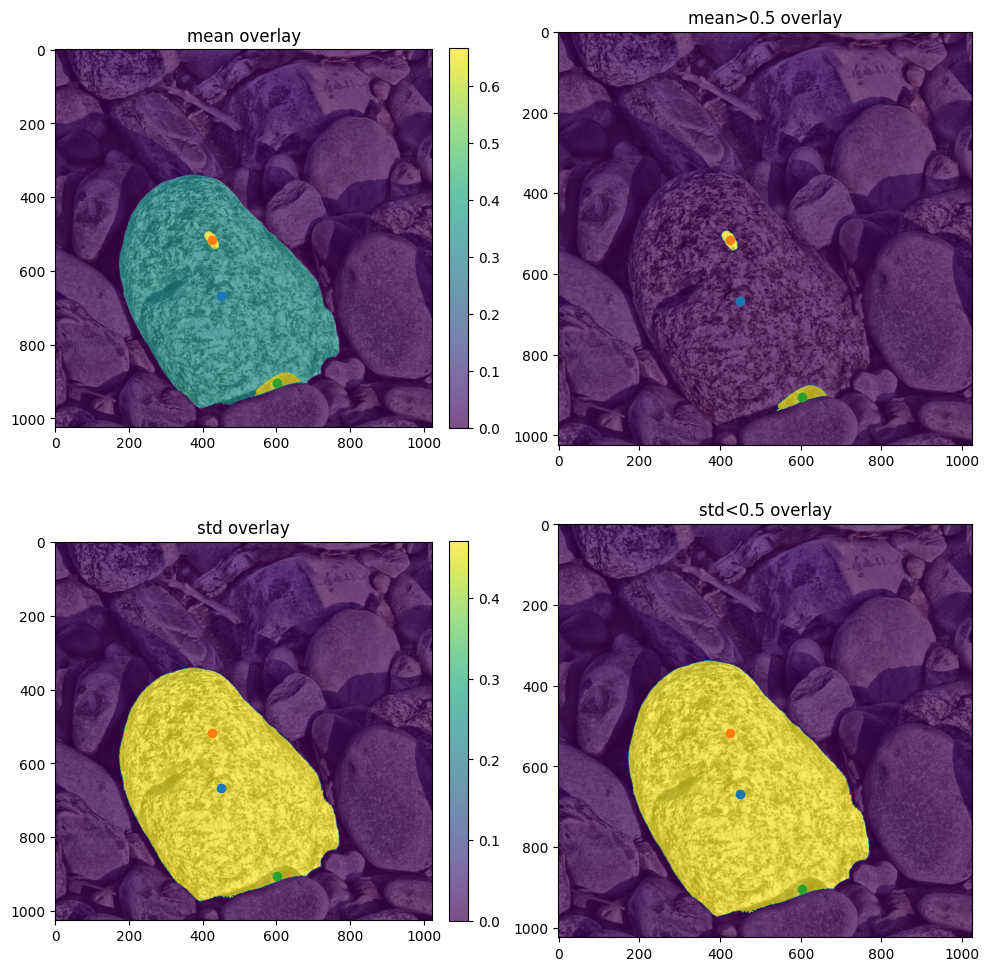

In [122]:
k=6
tm=0.5
ts=0.5
print(len(cleaned_groups[k]))
stacked=np.stack([list_of_masks[i] for i in cleaned_groups[k]])
mean_stacked=np.mean(stacked,axis=0)
std_stacked=np.std(stacked,axis=0)
fnc.mean_std_overlay(temp_image,list_of_masks,cleaned_groups,list_of_mask_centroid,k,ts,tm)

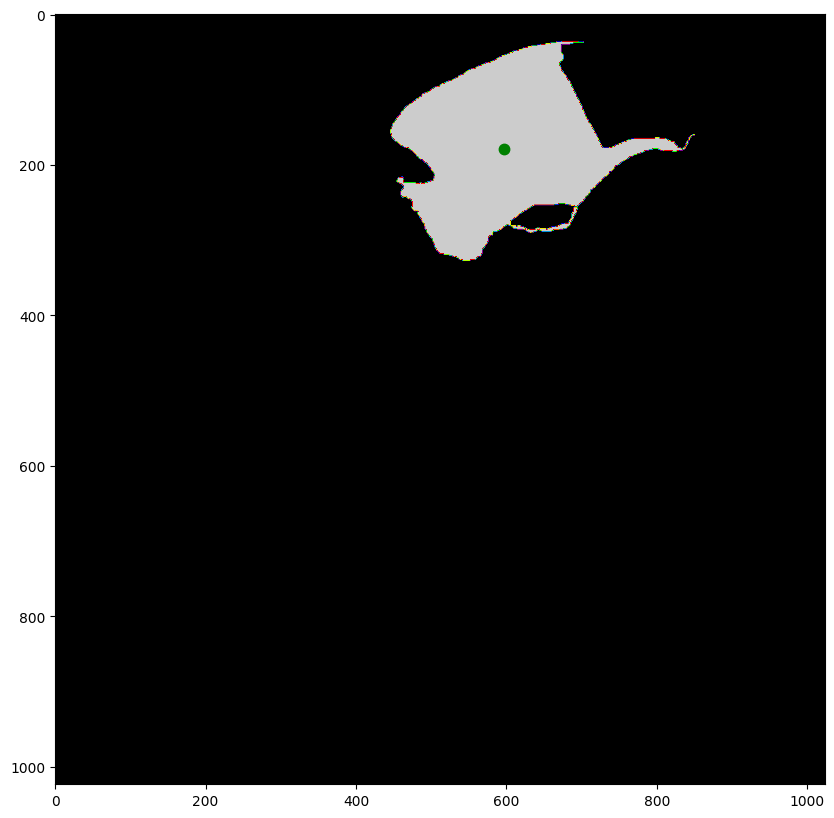

In [102]:
#plt.figure(figsize=(10, 10))
#labels=label(np.logical_and(std_stacked>0,std_stacked<ts))
labels=label(np.logical_and(mean_stacked<tm,mean_stacked>0))
label_id, count=np.unique(labels, return_counts=True)
label_t=np.zeros(labels.shape)
for id, c in zip(label_id,count):
    if (c>1000):#and (id!=0):
        label_t[labels==id]=id
        #plt.imshow(labels==id)
        #plt.show()
#plt.imshow(label_t, cmap='nipy_spectral')
#print(np.unique(label_t,return_counts=True))

regions=regionprops(labels)
fig, ax = plt.subplots(figsize=(10,10))
ax.imshow(label_t, cmap='nipy_spectral')

for props in regions:
    if props.area>100:
        y0, x0 = props.centroid
        ax.plot(x0, y0, '.g', markersize=15)
plt.show()

In [103]:
regions=regionprops(labels)
regions2=regionprops(labels)

In [104]:
for region in regions2:
    regions.append(region) 

In [ ]:
for props in regions:
    if props.area>100:
        y0, x0 = props.centroid
        input_point = np.array([[x0,y0]])
        input_label = np.array([1])

        partmasks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True,)

        for i, (mask, score) in enumerate(zip(partmasks, scores)):
            plt.figure(figsize=(10,10))
            plt.imshow(temp_image)
            fnc.show_mask(mask, plt.gca())
            fnc.show_points(input_point, input_label, plt.gca())
            plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
            plt.axis('off')
            plt.show()  

In [35]:
#apply to all groups    
tm=0.5
ts=0.5
cleaned_groups_reseg=[]
for k in range(len(cleaned_groups)):
    stacked=np.stack([list_of_masks[i] for i in cleaned_groups[k]])
    mean_stacked=np.mean(stacked,axis=0)
    std_stacked=np.std(stacked,axis=0)
    
    #group_reseg=[]

    #separate high confidence region(high mean) and low
    labels=label(np.logical_and(mean_stacked<=tm,mean_stacked>0))
    regions=regionprops(labels)
    labels=label(np.logical_and(mean_stacked>tm,mean_stacked>0))
    regions_highmean=regionprops(labels)
    for region in regions_highmean:
        regions.append(region) 

    for props in regions:
        if props.area>100:#apply minimum area to filter out mini residuals
            y0, x0 = props.centroid
            input_point = np.array([[x0,y0]])
            input_label = np.array([1])

            partmasks, scores, logits = predictor.predict(
                point_coords=input_point,
                point_labels=input_label,
                multimask_output=True,)
            best_idx=np.argmax(scores)#pick the mask with highest score
            cleaned_groups_reseg.append({'mask':partmasks[best_idx],'score':scores[best_idx],'logit':logits[best_idx],'group':k})
    

In [36]:
list_of_cleaned_groups_reseg_masks = [fnc.clean_mask(mask['mask'].astype(np.uint8)) for mask in cleaned_groups_reseg]
list_of_cleaned_groups_reseg_score=[mask['score'] for mask in cleaned_groups_reseg]

In [37]:
for m in list_of_nooverlap_mask:
    if np.sum(list_of_masks[m])>threshold:
        list_of_cleaned_groups_reseg_masks.append(list_of_masks[m].astype(np.uint8))
        list_of_cleaned_groups_reseg_score.append(list_of_pred_iou[m])

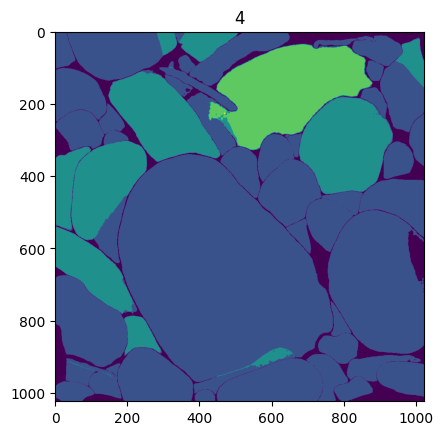

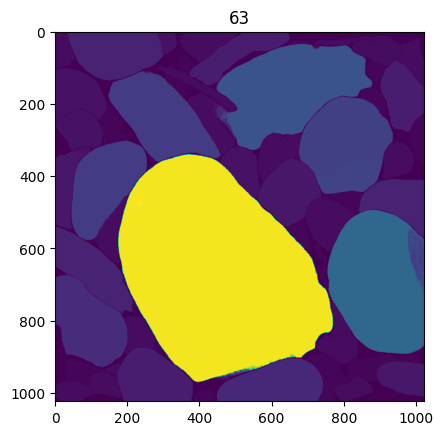

In [38]:
plt.imshow(np.sum(list_of_cleaned_groups_reseg_masks,axis=0))
plt.title(np.max(np.sum(list_of_cleaned_groups_reseg_masks,axis=0)));
plt.show()
plt.imshow(np.sum(list_of_masks,axis=0))
plt.title(np.max(np.sum(list_of_masks,axis=0)));

In [39]:
def find_bounding_boxes(binary_mask):
    bboxes = []
    binary_mask=torch.tensor(binary_mask, device=DEVICE, dtype=torch.float)
    labels = torch.unique(binary_mask)
    for label in labels:
        if label == 0:
            continue  # skip the background
        positions = torch.nonzero(binary_mask == label)
        if positions.numel() == 0:
            continue
        y_min, x_min = positions.min(dim=0)[0]
        y_max, x_max = positions.max(dim=0)[0]
        bboxes.append([x_min.item(), y_min.item(), x_max.item() + 1, y_max.item() + 1])
    return bboxes[0]

In [40]:
#NMS filtering
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in list_of_cleaned_groups_reseg_masks], device=DEVICE, dtype=torch.float)
scores = torch.tensor(list_of_cleaned_groups_reseg_score, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])

keep = batched_nms(bboxes, scores, labels, 0.3)
list_of_cleaned_groups_reseg_masks_nms=[list_of_cleaned_groups_reseg_masks[i] for i in keep]
len(list_of_cleaned_groups_reseg_masks_nms)

50

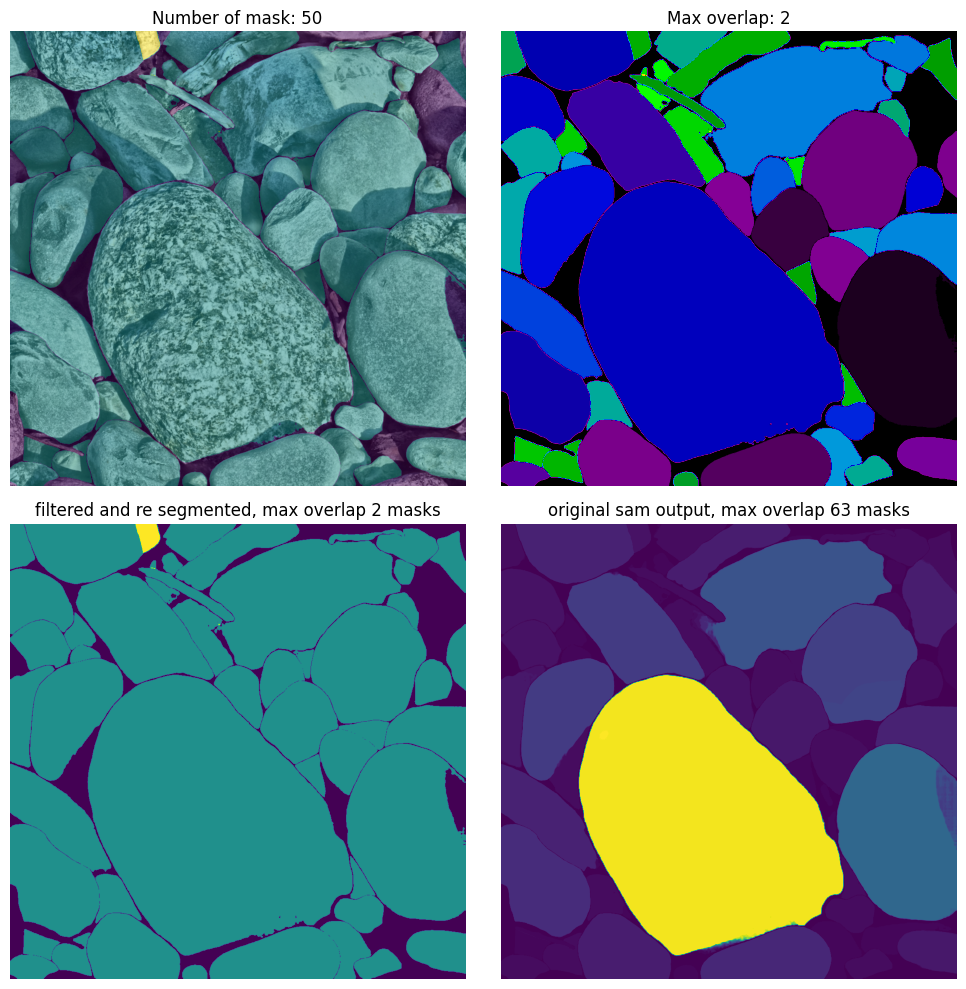

In [41]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(temp_image)
plt.imshow(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0),alpha=0.5)
plt.title(f'Number of mask: {len(list_of_cleaned_groups_reseg_masks_nms)}')
plt.axis('off')
plt.subplot(2,2,2)
#plt.imshow(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0))
plt.imshow(np.sum([list_of_cleaned_groups_reseg_masks_nms[i]*(i+1) for i in range(len(list_of_cleaned_groups_reseg_masks_nms))],axis=0), cmap='nipy_spectral')
plt.title(f'Max overlap: {np.max(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0))}')
plt.axis('off');
plt.subplot(2,2,3)
plt.imshow(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0))
plt.axis('off')
plt.title(f'filtered and re segmented, max overlap {np.max(np.sum(list_of_cleaned_groups_reseg_masks_nms,axis=0))} masks');
plt.subplot(2,2,4)
plt.imshow(np.sum(list_of_masks,axis=0))
plt.axis('off')
plt.title(f'original sam output, max overlap {np.max(np.sum(list_of_masks,axis=0))} masks')
plt.tight_layout()
plt.show()

In [42]:
# checking accuracy
crop_size=1024
i=0
j=0
temp_seg_id=seg_ids[crop_size*i:crop_size*(i+1),crop_size*j:crop_size*(j+1)]

seg_labels=(np.unique(temp_seg_id)[1:])

seg_size=[]
for seg in seg_labels:
    seg_size.append(np.sum(temp_seg_id==seg))

seg_size_sort_idx=np.argsort(seg_size)

list_of_label=[(temp_seg_id==seg_labels[index]).astype(np.uint8) for index in seg_size_sort_idx]
list_of_label_centroid = [fnc.get_centroid(mask) for mask in list_of_label]
ar_label=np.stack(list_of_label)

list_of_mask_centroid = [fnc.get_centroid(mask) for mask in list_of_cleaned_groups_reseg_masks_nms]
ar_masks=np.stack(list_of_cleaned_groups_reseg_masks_nms)

ar_all=np.stack(list_of_label+list_of_cleaned_groups_reseg_masks_nms)
list_of_centroid = [fnc.get_centroid(ar_all[i]) for i in range(len(ar_all))]

In [43]:
from sklearn.neighbors import KDTree
tree = KDTree(list_of_centroid)              
k=4
_, ind = tree.query(list_of_centroid[:len(list_of_label)], k=k)

# get nearest centroid iou
kdc_iou=[]
nearest_mask_pick=[]
for match in ind:
    #check if nearest neighbor is not a label
    j=1
    while match[j]<len(list_of_label):
        j+=1
        if j==k:
            break
    if j<k:
        kdc_iou.append(fnc.iou(ar_all[match[0]],ar_all[match[j]]))
        nearest_mask_pick.append(match[j])
    else:
        kdc_iou.append(-0.1)

In [44]:
ar_all_flat=ar_all.reshape((ar_all.shape[0],ar_all.shape[1]*ar_all.shape[2]))
set_overlap = set()

# Iterate through each column of the array
for i in range(ar_all_flat.shape[1]):
    # for each pixel find out the idex of mask where the pixel was in a mask
    nz = np.where(ar_all_flat[:, i] != 0)[0]
    
    # if there are overlap of mask
    if len(nz) > 1:
        nz_tuple = tuple(nz)
        set_overlap.add(nz_tuple)

# Convert the set back to a list if needed
list_overlap = list(set_overlap)

In [45]:
ar_all.shape

(116, 1024, 1024)

In [46]:
# get all average and max iou
overlap_by_label=[]
mask_label_inter=[]
max_iou=[]
avg_iou=[]
max_mask_pick=[]
for i in range(len(list_of_label)):
    all_pairs=[tup for tup in list_overlap if i in tup]
    if len(all_pairs)>0:
        overlap_with_i=np.unique(np.hstack(all_pairs))[1:]
        overlap_by_label.append(overlap_with_i)
        agg_iou=[]
        agg_inter=[]
        for j in overlap_with_i:
            agg_iou.append(fnc.iou(ar_label[i],ar_masks[j-len(list_of_label)]))
            agg_inter.append(np.logical_and(ar_label[i], ar_masks[j-len(list_of_label)]).sum())
        mask_label_inter.append(agg_inter)
        avg_iou.append(np.mean(agg_iou))
        max_iou.append(np.max(agg_iou))
        max_mask_pick.append(overlap_with_i[np.argmax(agg_iou)])
    else:
        overlap_by_label.append(np.array([]))
        mask_label_inter.append(np.array([]))
        avg_iou.append(-0.1)
        max_iou.append(-0.1)

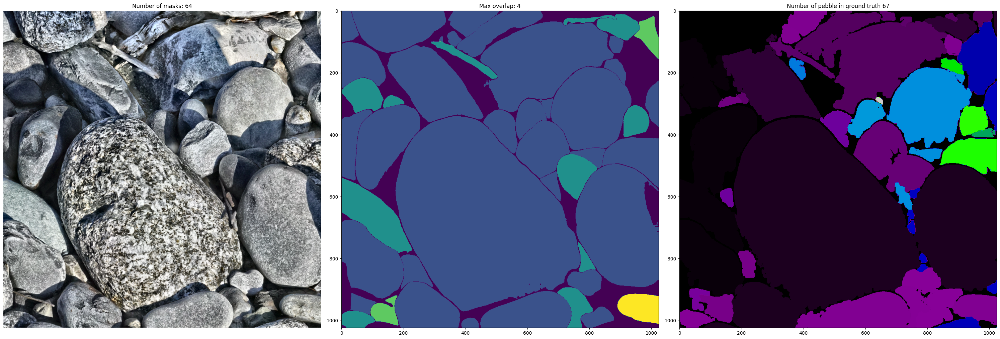

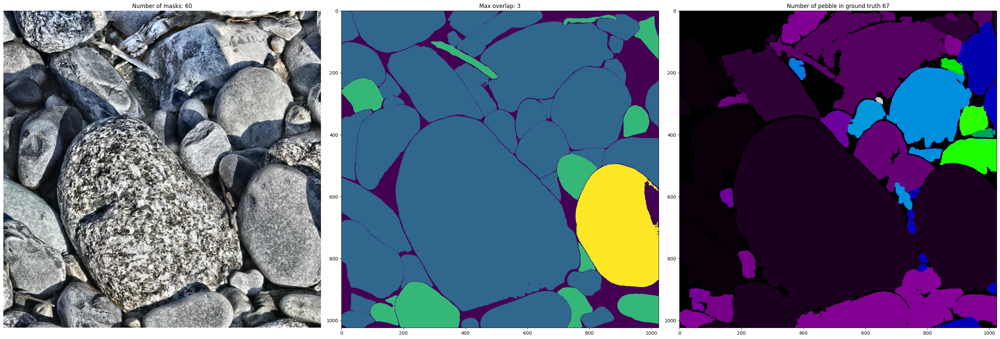

In [47]:
nearest_subset_masks=[list_of_cleaned_groups_reseg_masks_nms[i-len(list_of_label)] for i in nearest_mask_pick]
max_subset_masks=[list_of_cleaned_groups_reseg_masks_nms[i-len(list_of_label)] for i in max_mask_pick]

for t_masks in [nearest_subset_masks,max_subset_masks]:
    fig, ax = plt.subplots(1,3,figsize=(30,20))
    ax=ax.flatten()
    i=0
    ax[i*2].imshow(temp_image)
    #fnc.show_anns_mod_ax(t_masks, ax[i*2], label=None, sort=False)
    ax[i*2].set_title(f'Number of masks: {len(t_masks)}')
    ax[i*2].axis('off')
    #list_of_masks = [mask['mask'].astype(np.uint8) for mask in t_masks]
    ar_masks=np.stack(t_masks) 
    ax[i*2+1].imshow(np.sum(ar_masks,axis=0))
    ax[i*2+1].set_title(f'Max overlap: {np.unique(np.sum(ar_masks,axis=0)).max()}')  
    ax[2].imshow(temp_seg_id, cmap='nipy_spectral')  
    ax[2].set_title(f'Number of pebble in ground truth {len(np.unique(temp_seg_id))}')   
    plt.tight_layout()
    plt.show()

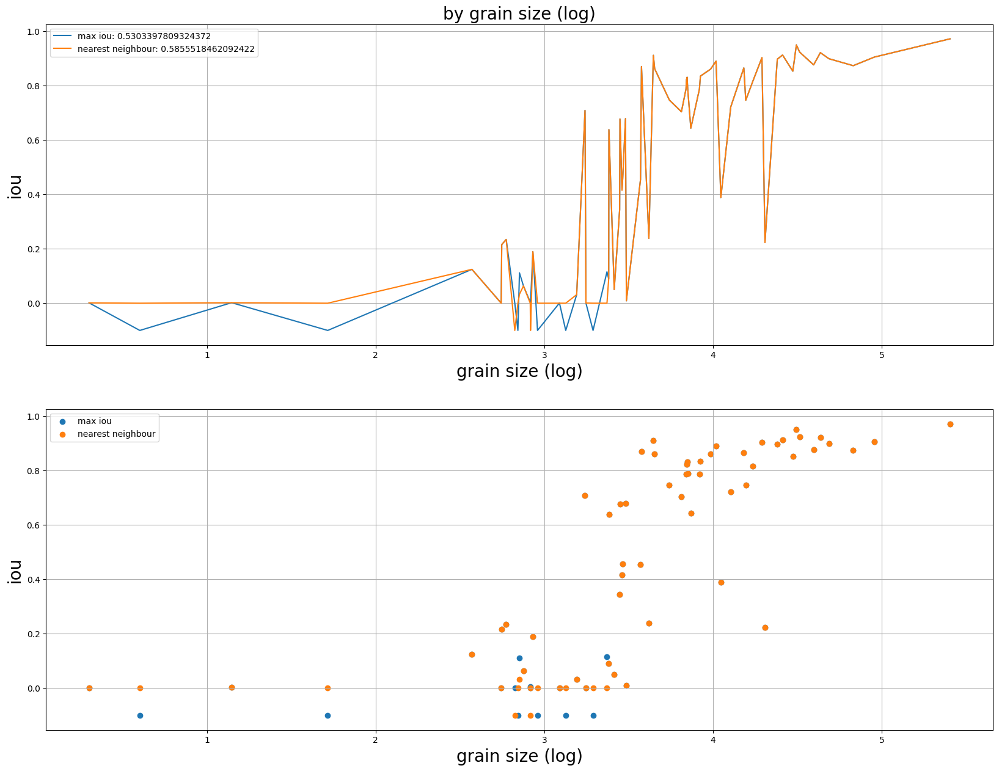

In [48]:
max_iou=np.array(max_iou)
kdc_iou=np.array(kdc_iou)

fig,ax=plt.subplots(2,1,figsize=(20,15))
ax=ax.flatten()
#ax[0].plot(np.log10([seg_size[i] for i in seg_size_sort_idx]),avg_iou,label='average iou')
ax[0].plot(np.log10([seg_size[i] for i in seg_size_sort_idx]),max_iou,label=f'max iou: {np.mean(max_iou[max_iou>0])}')
ax[0].plot(np.log10([seg_size[i] for i in seg_size_sort_idx]),kdc_iou,label=f'nearest neighbour: {np.mean(kdc_iou[kdc_iou>0])}')
ax[0].set_xlabel('grain size (log)', fontsize=20)
ax[0].set_ylabel('iou', fontsize=20)
ax[0].grid()
ax[0].legend()
#ax[1].scatter(np.log10([seg_size[i] for i in seg_size_sort_idx]),avg_iou,label='average iou')
ax[1].scatter(np.log10([seg_size[i] for i in seg_size_sort_idx]),max_iou,label='max iou')
ax[1].scatter(np.log10([seg_size[i] for i in seg_size_sort_idx]),kdc_iou,label='nearest neighbour')
ax[1].set_xlabel('grain size (log)', fontsize=20)
ax[1].set_ylabel('iou', fontsize=20)
ax[1].grid()
ax[1].legend()
ax[0].set_title('by grain size (log)', fontsize=20)
plt.show()

In [118]:
np.mean(np.array(list_of_mask_centroid)[cleaned_groups[k]],axis=0)

array([186.18368864,  67.5946352 ])

In [119]:
input_point = np.array([np.mean(np.array(list_of_mask_centroid)[cleaned_groups[k]],axis=0)[::-1]])
input_label = np.array([1])

  


#plt.figure(figsize=(10,10))
#plt.imshow(temp_image)
#fnc.show_points(input_point, input_label, plt.gca())
#plt.axis('on')
#plt.show()  

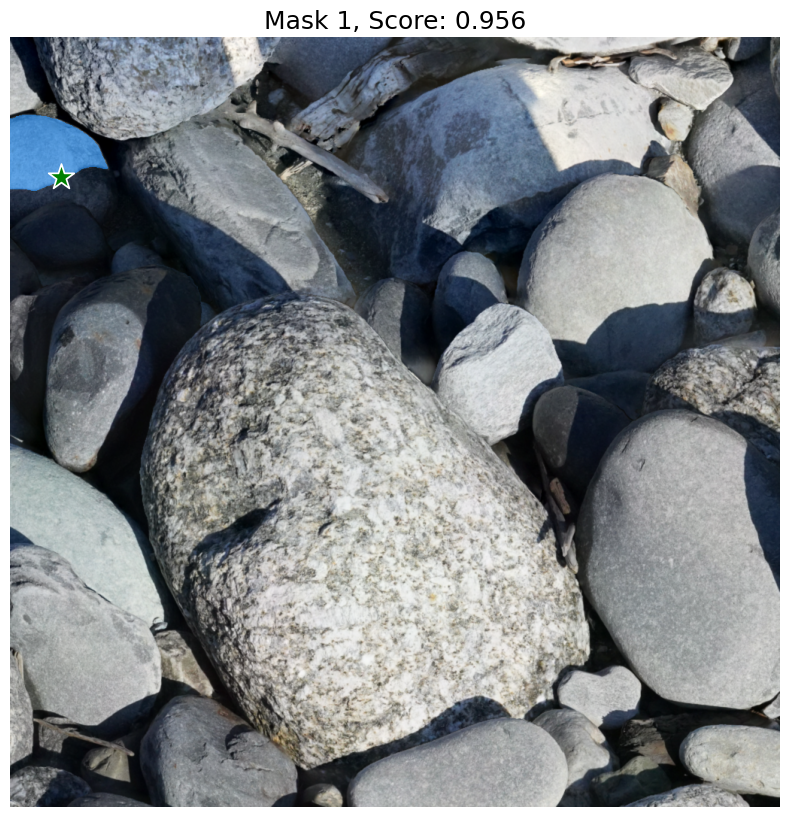

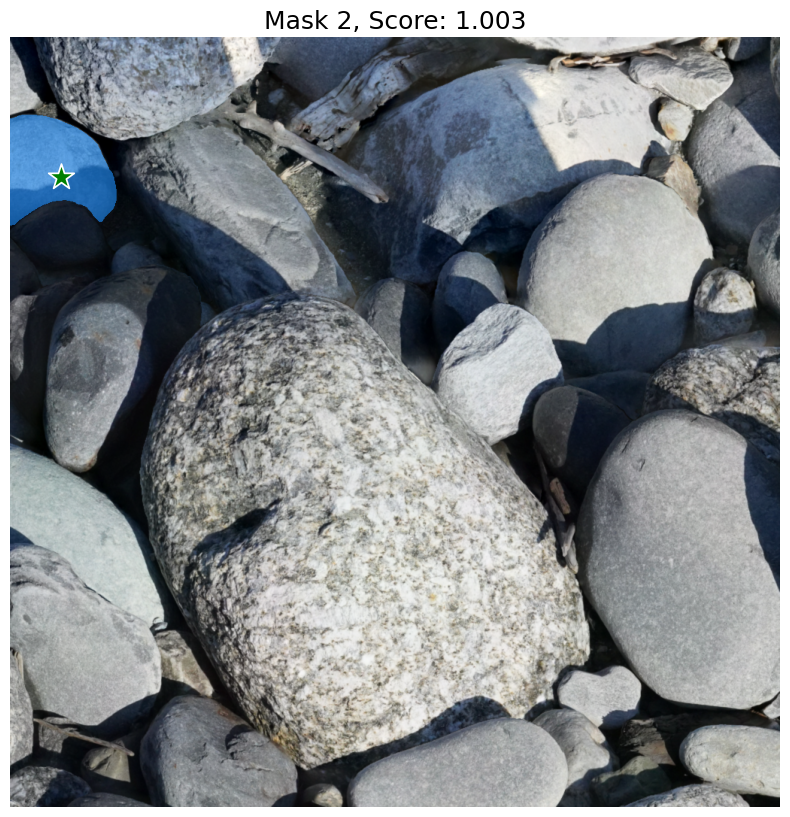

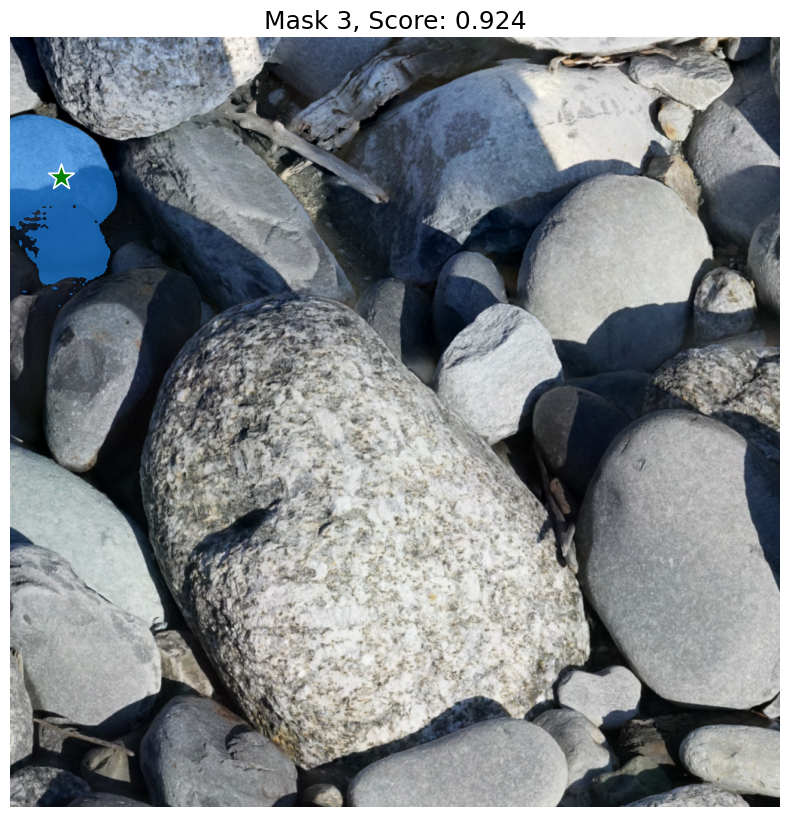

In [120]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(temp_image)
    fnc.show_mask(mask, plt.gca())
    fnc.show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  
  

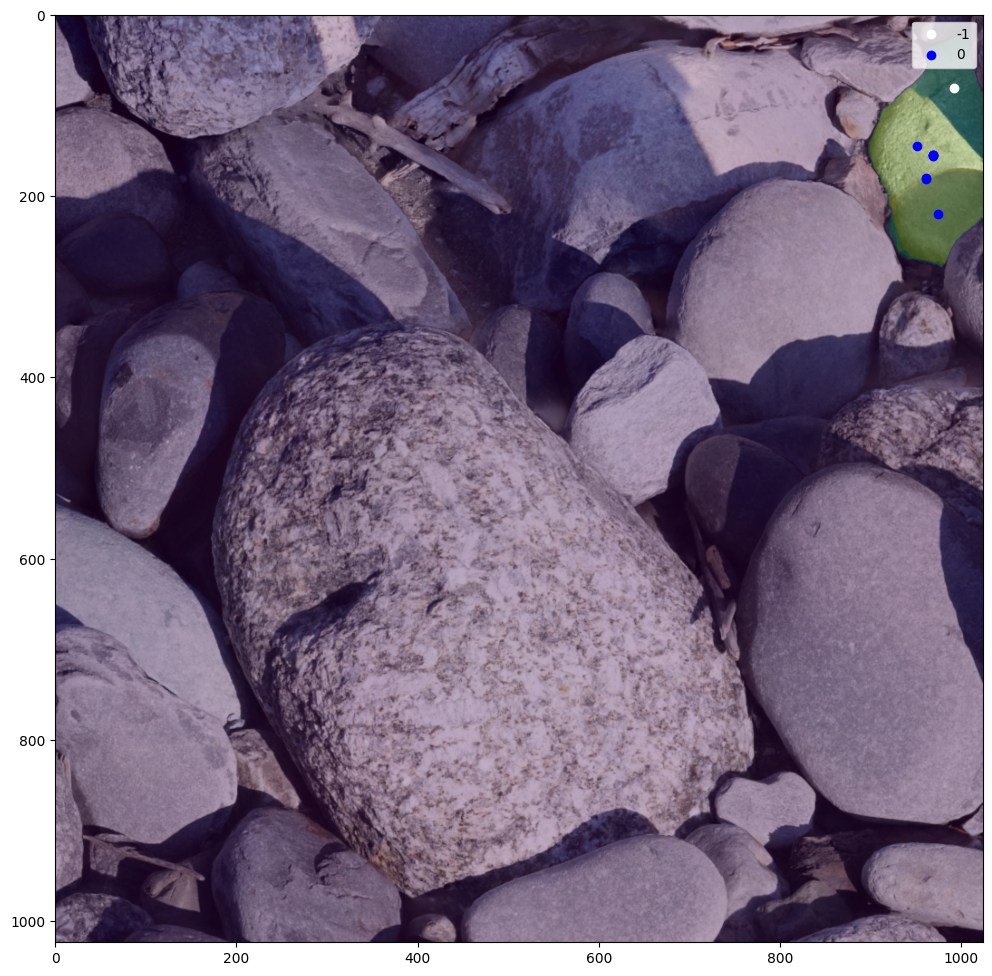

In [112]:
from sklearn.cluster import DBSCAN
#group centroid
k=4
group_centroid=[list_of_mask_centroid[i] for i in cleaned_groups[k]]
group_centroid
#dbscan clustering
dbscan = DBSCAN(eps=50, min_samples=5)
labels = dbscan.fit_predict(np.array(group_centroid))

fig = plt.figure(figsize=(10, 10))
plt.imshow(temp_image)
plt.imshow(np.sum(np.stack([list_of_masks[i] for i in cleaned_groups[k]]),axis=0), alpha=0.3)
color=['w','b','g','y','orange','red','purple','pink']
for i,label in enumerate(np.unique(labels)):

    filter_label=np.array([labels==label])[0]
    
    plt.scatter([centroid[1] for centroid in np.array(group_centroid)[filter_label]], 
                [centroid[0] for centroid in np.array(group_centroid)[filter_label]], 
                c=color[i], label=label)
    #plt.set_title(f'group {label}. {np.sum(filter_label)} samples')
plt.legend()
plt.tight_layout()
plt.show()


Unique labels (clusters): {0, 1}


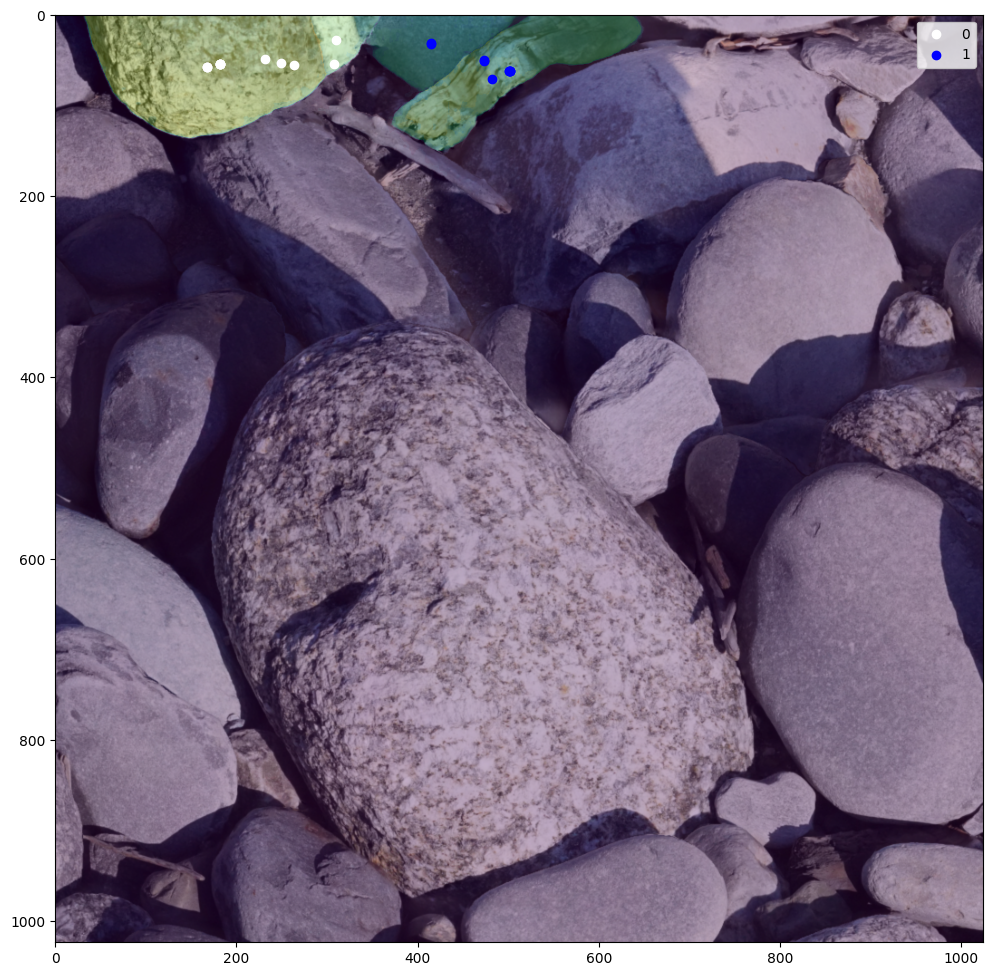

In [69]:
from sklearn.cluster import MeanShift
#group centroid
k=1
group_centroid=[list_of_mask_centroid[i] for i in cleaned_groups[k]]
group_centroid
#dbscan clustering
bandwidth = 100  # Define the bandwidth parameter
mean_shift = MeanShift(bandwidth=bandwidth)
labels = mean_shift.fit_predict(np.array(group_centroid))

# Print unique labels to see the clustering result
unique_labels = set(labels)
print("Unique labels (clusters):", unique_labels)

fig = plt.figure(figsize=(10, 10))
plt.imshow(temp_image)
plt.imshow(np.sum(np.stack([list_of_masks[i] for i in cleaned_groups[k]]),axis=0), alpha=0.3)
color=['w','b','g','y','orange','red','purple','pink']
for i,label in enumerate(np.unique(labels)):

    filter_label=np.array([labels==label])[0]
    
    plt.scatter([centroid[1] for centroid in np.array(group_centroid)[filter_label]], 
                [centroid[0] for centroid in np.array(group_centroid)[filter_label]], 
                c=color[i], label=label)
    #plt.set_title(f'group {label}. {np.sum(filter_label)} samples')
plt.legend()
plt.tight_layout()
plt.show()

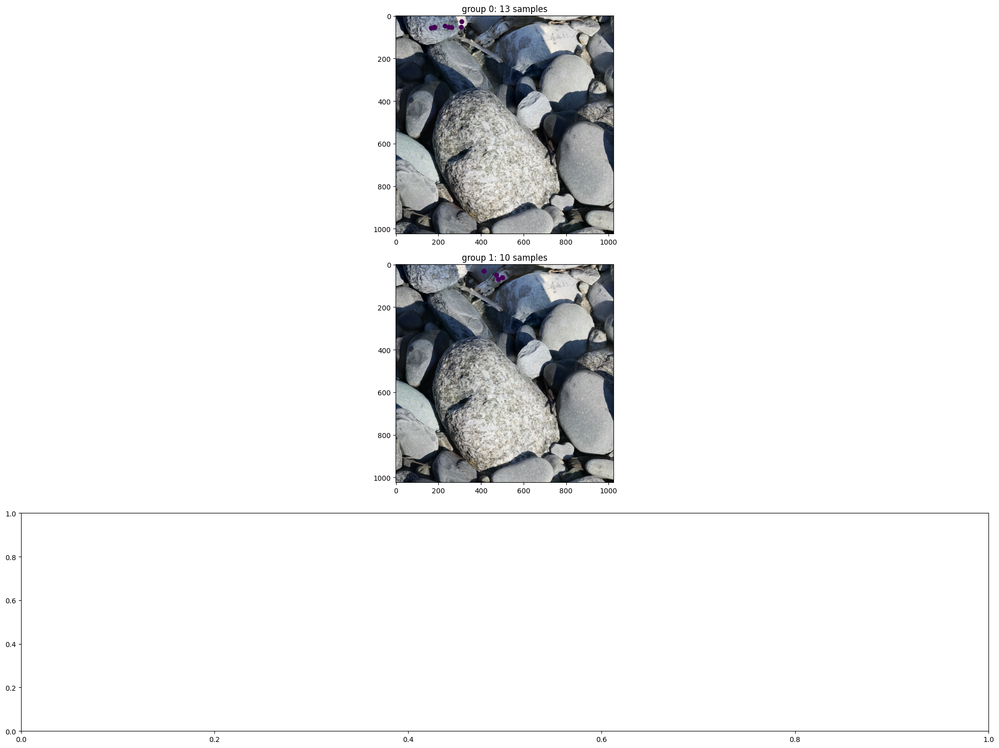

In [71]:
fig, ax=plt.subplots(3,len(np.unique(labels))//3+1, figsize=(20,15))
ax=ax.flatten()
for i,label in enumerate(np.unique(labels)):

    filter_label=np.array([labels==label])[0]
    ax[i].imshow(temp_image)
    ax[i].scatter([centroid[1] for centroid in np.array(group_centroid)[filter_label]], 
                [centroid[0] for centroid in np.array(group_centroid)[filter_label]], 
                c=np.array(labels)[filter_label], cmap='viridis')
    ax[i].set_title(f'group {label}: {np.sum(filter_label)} samples')
plt.tight_layout()
plt.show()


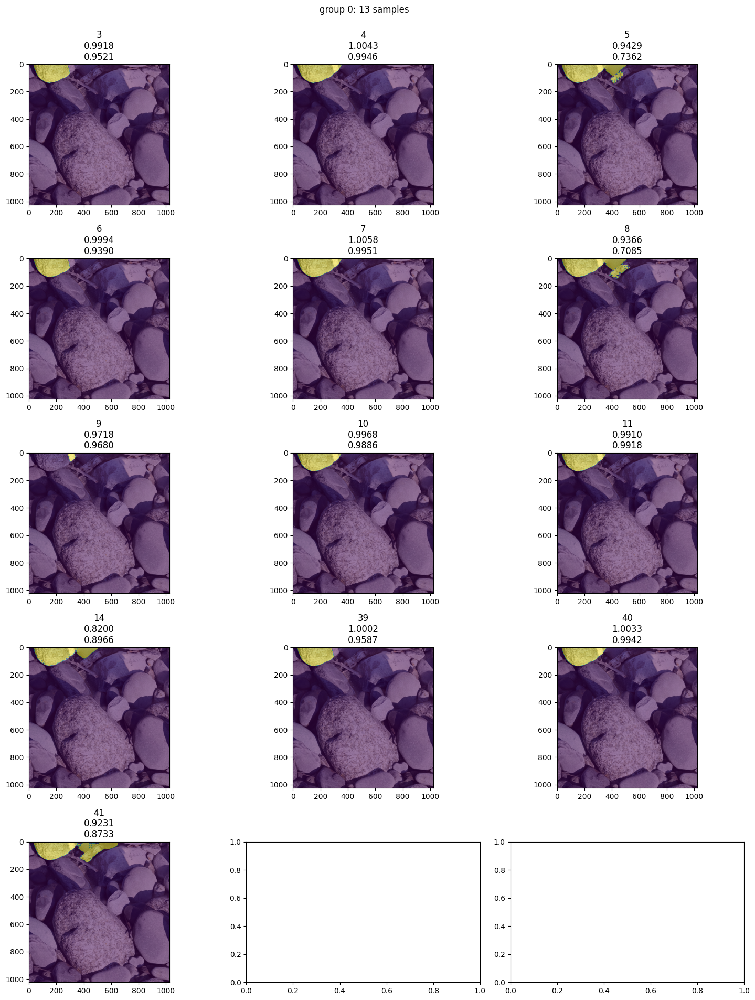

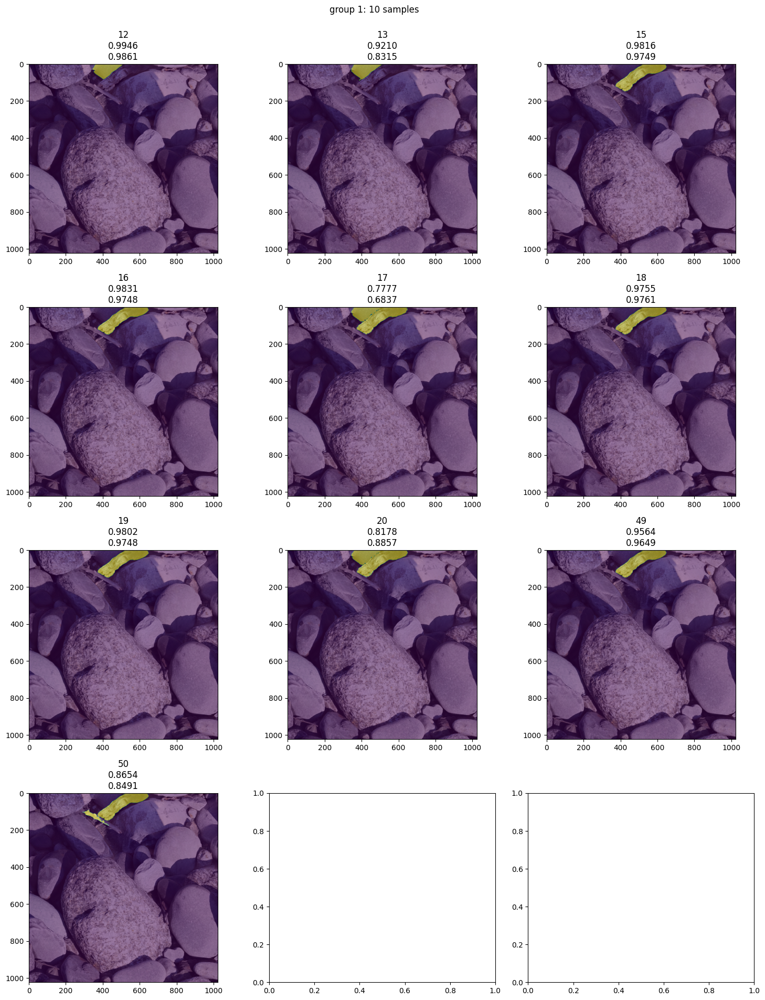

In [91]:
for i,label in enumerate(np.unique(labels)):

    filter_label=np.array([labels==label])[0]
    fig, ax=plt.subplots(np.sum(filter_label)//3+1,3, figsize=(15,20))
    ax=ax.flatten()
    for axi, j in enumerate(np.where(filter_label==True)[0]):
        ax[axi].imshow(temp_image)
        #ax[axi].imshow(list_of_logits[cleaned_groups[k][j]], alpha=0.5)
        ax[axi].imshow(list_of_masks[cleaned_groups[k][j]], alpha=0.5)
        ax[axi].set_title(f'{cleaned_groups[k][j]}\n{list_of_pred_iou[cleaned_groups[k][j]]:.4f}\n{list_of_stability_score[cleaned_groups[k][j]]:.4f}')
    plt.suptitle(f'group {label}: {np.sum(filter_label)} samples')
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.show()


In [74]:
np.where(filter_label==True)[0]

array([ 9, 10, 12, 13, 14, 15, 16, 17, 21, 22])

In [ ]:
mask1=list_of_masks[cleaned_groups[k][1]]
mask2=list_of_masks[cleaned_groups[k][6]]
intersection = np.logical_and(mask1, mask2)

np.sum(intersection)
#base on l band check if these are bright side and shadow side and by comparing a b band see if they are identical?

In [ ]:
target=60
overlaps_with_target=[]
for ls in list_overlap:
    if np.any(target == ls[0]):
        overlaps_with_target.append(ls[0])

In [ ]:
overlaps_with_target=np.unique(np.hstack(overlaps_with_target))
overlaps_with_target=overlaps_with_target[overlaps_with_target != target]
overlaps_with_target

In [ ]:
np.unique(label(ar_masks[60]))

In [ ]:
labels = label(ar_masks[60])
regions = regionprops(labels)

# Sort regions by area
sorted_regions = sorted(regions, key=lambda x: x.area, reverse=True)

# Print sorted regions by area
for region in sorted_regions:
    print(f"Label: {region.label}, Area: {region.area}")

In [ ]:
plt.imshow(label(ar_masks[60])==2)

In [ ]:
plt.imshow(np.sum(ar_masks[overlaps_with_target],axis=0))